In [1]:
# import libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns; sns.set()
import plotly.express as px
from sklearn.decomposition import PCA

from sklearn.preprocessing import StandardScaler

%matplotlib inline

In [12]:
df=pd.read_csv("D:/Chathurangis/IBM/COVID19-eng/COVID19-eng.csv")
df

,Case identifier number,Region,Episode week,Episode week group,Episode year,Gender,Age group,Occupation,Asymptomatic,Onset week of symptoms,...,"Symptom, pain","Symptom, irritability","Symptom, diarrhea","Symptom, other",Hospital status,Recovered,Recovery week,Recovery year,Death,Transmission
0,1,3,41,0,20,2,3,4,9,41,...,9,9,9,9,3,9,99,99,9,1
1,2,4,31,0,20,2,2,4,2,31,...,9,9,9,9,3,1,33,20,2,1
2,3,2,39,0,20,2,8,4,1,99,...,9,9,9,9,3,1,43,20,2,9
3,4,3,40,0,20,1,2,4,9,40,...,9,9,9,9,9,1,99,99,2,1
4,5,3,42,0,20,2,1,4,9,42,...,9,9,9,9,9,1,99,99,2,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
360231,360232,4,44,0,20,1,1,4,2,44,...,9,9,9,1,3,9,99,99,9,1
360232,360233,2,47,0,20,2,5,4,9,47,...,9,9,9,9,3,9,99,99,9,9
360233,360234,4,99,0,20,1,5,4,2,99,...,1,1,9,1,1,1,29,20,2,2
360234,360235,3,20,0,20,1,4,4,9,20,...,9,9,9,9,9,1,99,99,2,1


In [13]:
df.columns

Index(['Case identifier number', 'Region', 'Episode week',
       'Episode week group', 'Episode year', 'Gender', 'Age group',
       'Occupation', 'Asymptomatic', 'Onset week of symptoms',
       'Onset year of symptoms', 'Symptom, cough', 'Symptom, fever',
       'Symptom, chills', 'Symptom, sore throat', 'Symptom, runny nose',
       'Symptom, shortness of breath', 'Symptom, nausea', 'Symptom, headache',
       'Symptom, weakness', 'Symptom, pain', 'Symptom, irritability',
       'Symptom, diarrhea', 'Symptom, other', 'Hospital status', 'Recovered',
       'Recovery week', 'Recovery year', 'Death', 'Transmission'],
      dtype='object')

In [14]:
len(df)

360236

In [15]:
df.shape

(360236, 30)

In [16]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 360236 entries, 0 to 360235
Data columns (total 30 columns):
 #   Column                        Non-Null Count   Dtype
---  ------                        --------------   -----
 0   Case identifier number        360236 non-null  int64
 1   Region                        360236 non-null  int64
 2   Episode week                  360236 non-null  int64
 3   Episode week group            360236 non-null  int64
 4   Episode year                  360236 non-null  int64
 5   Gender                        360236 non-null  int64
 6   Age group                     360236 non-null  int64
 7   Occupation                    360236 non-null  int64
 8   Asymptomatic                  360236 non-null  int64
 9   Onset week of symptoms        360236 non-null  int64
 10  Onset year of symptoms        360236 non-null  int64
 11  Symptom, cough                360236 non-null  int64
 12  Symptom, fever                360236 non-null  int64
 13  Symptom, chill

In [17]:
# Check for missing values
df.isnull().sum()

Case identifier number          0
Region                          0
Episode week                    0
Episode week group              0
Episode year                    0
Gender                          0
Age group                       0
Occupation                      0
Asymptomatic                    0
Onset week of symptoms          0
Onset year of symptoms          0
Symptom, cough                  0
Symptom, fever                  0
Symptom, chills                 0
Symptom, sore throat            0
Symptom, runny nose             0
Symptom, shortness of breath    0
Symptom, nausea                 0
Symptom, headache               0
Symptom, weakness               0
Symptom, pain                   0
Symptom, irritability           0
Symptom, diarrhea               0
Symptom, other                  0
Hospital status                 0
Recovered                       0
Recovery week                   0
Recovery year                   0
Death                           0
Transmission  

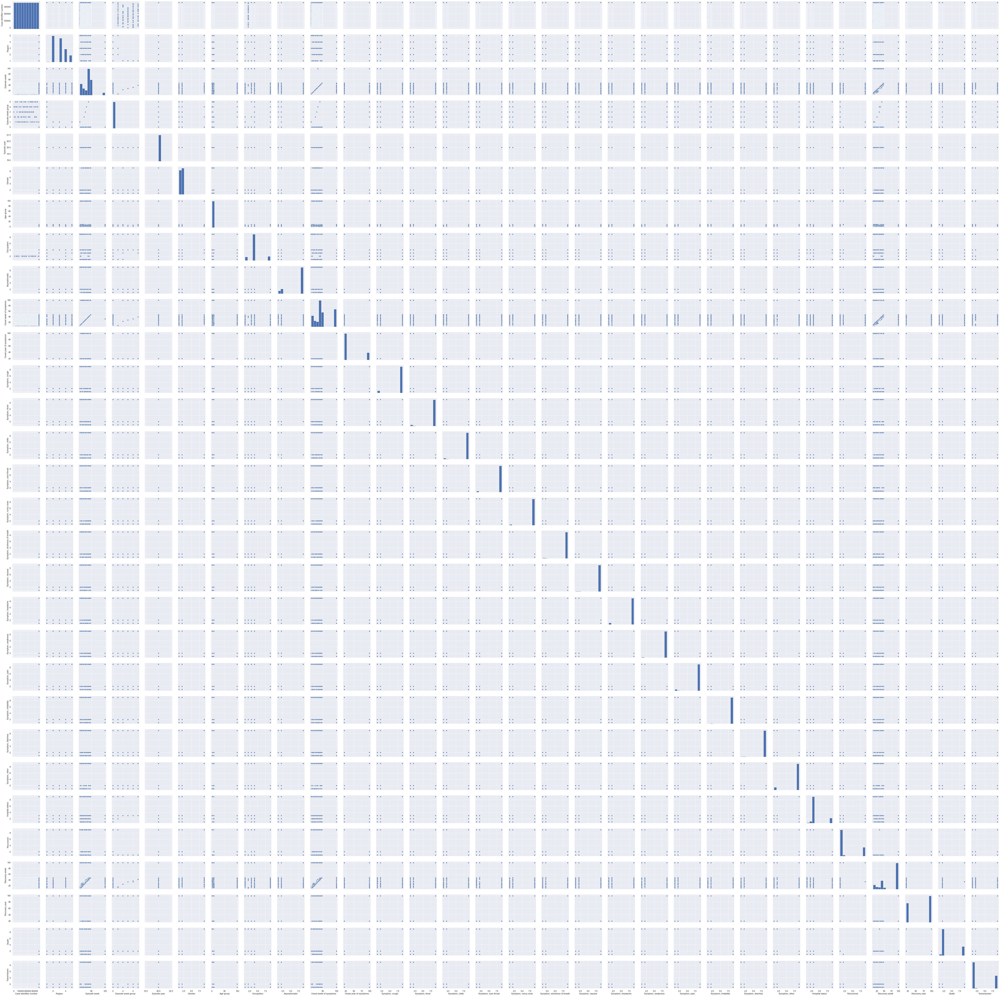

In [18]:
sns.pairplot(df)

selected columns Index(['Case identifier number', 'Region', 'Episode week',
       'Episode week group', 'Episode year', 'Gender', 'Age group',
       'Occupation', 'Asymptomatic', 'Onset week of symptoms',
       'Symptom, cough', 'Symptom, fever', 'Symptom, chills',
       'Symptom, sore throat', 'Symptom, runny nose',
       'Symptom, shortness of breath', 'Symptom, nausea', 'Symptom, headache',
       'Symptom, weakness', 'Symptom, pain', 'Symptom, irritability',
       'Symptom, diarrhea', 'Symptom, other', 'Hospital status', 'Recovered',
       'Recovery week', 'Transmission'],
      dtype='object')
No.of selected columns 27


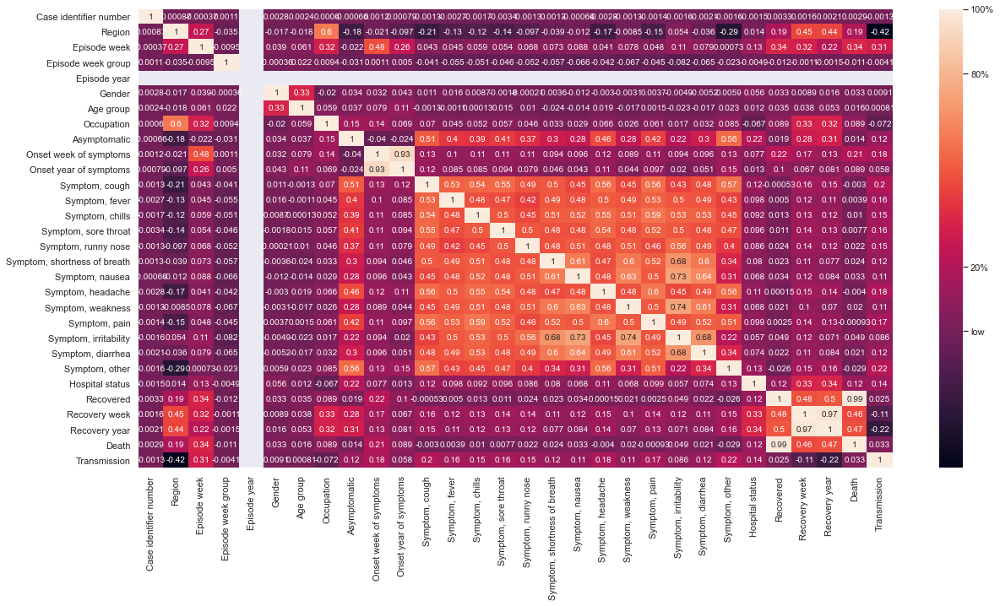

In [19]:
Var_Corr = df.corr()
# print(Var_Corr)

# plot the heatmap and annotation on it
plt.figure(figsize=(20, 10))
ax=sns.heatmap(Var_Corr, xticklabels=Var_Corr.columns, yticklabels=Var_Corr.columns, annot=True)
cbar = ax.collections[0].colorbar
cbar.set_ticks([0, .2, .8, 1])
cbar.set_ticklabels(['low', '20%', '80%', '100%'])

columns = np.full((Var_Corr.shape[0],), True, dtype=bool)
for i in range(Var_Corr.shape[0]):
    for j in range(i+1, Var_Corr.shape[0]):
        if Var_Corr.iloc[i,j] >= 0.9:
            if columns[j]:
                columns[j] = False
selected_columns = df.columns[columns]
data = df[selected_columns]
print("selected columns",selected_columns)
print("No.of selected columns",len(selected_columns))

Removed columns through correlation analysis are Onset year of symptoms, Recovery year, Death

# Statistical Data Analysis

In [8]:
#Get means value of the columns
print("Episode week mean : ",df["Episode week"].mean(),"weeks")
print("Onset week of symptoms mean : ",df["Onset week of symptoms"].mean(),"weeks")
print("Recovery week mean : ",df["Recovery week"].mean(),"weeks")

Episode week mean :  37.04423211450271 weeks
Onset week of symptoms mean :  48.71279661111049 weeks
Recovery week mean :  71.61817530729854 weeks


In [9]:
#most frequent data in the columns

print("Frequent Episode week : ",df.mode()['Episode week'][0])
print("Frequent Onset week of symptoms : ",df.mode()['Onset week of symptoms'][0])
print("Frequent Recovery week : ",df.mode()['Recovery week'][0])
print("Frequent Region : ",df.mode()['Region'][0])

Frequent Episode week :  45.0
Frequent Onset week of symptoms :  99.0
Frequent Recovery week :  99.0
Frequent Region :  2.0


In [10]:
# Get the minimum and maximum values of columns

print("Min Episode week : ",df['Episode week'].min())
print("Max Episode week : ",df['Episode week'].max())

print("Min Onset week of symptoms : ",df['Onset week of symptoms'].min())
print("Max Onset week of symptoms : ",df['Onset week of symptoms'].max())

print("Min Recovery week : ",df['Recovery week'].min())
print("Max Recovery week : ",df['Recovery week'].max())

Min Episode week :  8
Max Episode week :  99
Min Onset week of symptoms :  8
Max Onset week of symptoms :  99
Min Recovery week :  12
Max Recovery week :  99


# Outliers detection

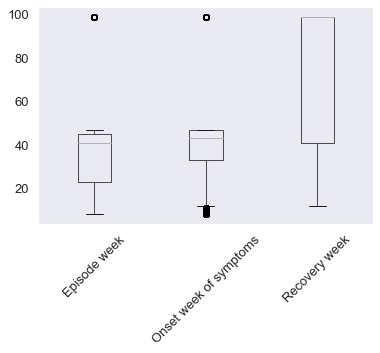

In [11]:
boxplot = df.boxplot(column=['Episode week','Onset week of symptoms','Recovery week'],rot=45, fontsize=13,grid = False)

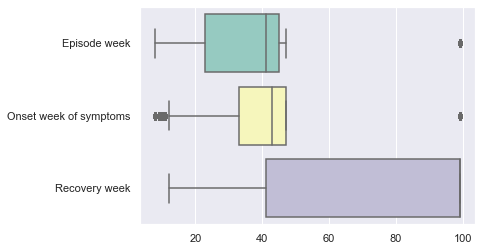

In [12]:
# Here I first used the data preprocessing technique of feature subset selection
df_ana=df[['Episode week','Onset week of symptoms','Recovery week']]
ax = sns.boxplot(data=df_ana, orient="h", palette="Set3")

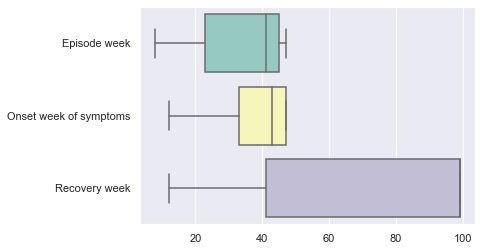

In [13]:
# Remove outliers in the above boxplot
ax = sns.boxplot(data=df_ana, orient="h", palette="Set3",showfliers=False)

# Data Analysis and Visualizations

[Text(0, 0, 'Atlantic'),
 Text(0, 0, 'Quebec'),
 Text(0, 0, 'Ontario and Nunavut'),
 Text(0, 0, 'Prairies '),
 Text(0, 0, 'British Columbia and Yukon')]

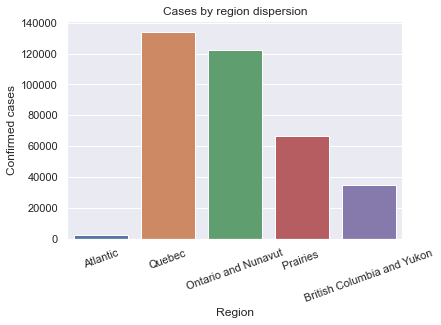

In [14]:
# 1. Cases by region dispersion in the dataset
df['Region'].value_counts()
regioncounts=df['Region'].value_counts().to_list()
Regions = ['Atlantic', 'Quebec', 'Ontario and Nunavut', 'Prairies ', 'British Columbia and Yukon']
ax=sns.countplot(df['Region'])
ax.set_title('Cases by region dispersion')
ax.set_ylabel('Confirmed cases')
ax.set_xticklabels(Regions,rotation=20)

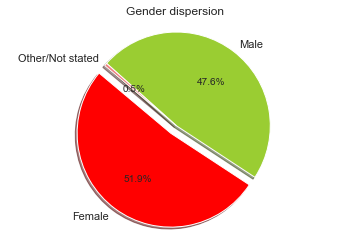

<Figure size 432x288 with 0 Axes>

In [15]:
# 2. Gender dispersion in the dataset
df['Gender'].value_counts()
gendercounts=df['Gender'].value_counts().to_list()

labels = 'Female', 'Male', 'Other/Not stated'
sizes = gendercounts
colors = ['red', 'yellowgreen', 'lightcoral']
explode = (0.1, 0,0)  # explode 1st slice

# Plot
plt.pie(sizes, explode=explode, labels=labels, colors=colors,
autopct='%1.1f%%', shadow=True, startangle=140)
plt.axis('equal')
plt.title("Gender dispersion")
plt.show()
plt.savefig('genderpiechart.jpg', format='jpg', dpi=1600)

In [16]:
# 3.Age groups dispersion in the dataset
df['Age group'].value_counts()
gendercounts=df['Age group'].value_counts().to_list()
labels = '20 to 29', '30 to 39', '0 to 19','40 to 49','50 to 59','80 years or older','60 to 69','70 to 79','Not Stated'
sizes = agecounts
colors = ['red', 'yellowgreen', 'lightcoral', 'lightskyblue','purple','orange','gold','pink','green']
explode = (0.1, 0,0,0,0,0,0,0,0)  # explode 1st slice

# Plot
plt.pie(sizes, explode=explode, labels=labels, colors=colors,
autopct='%1.1f%%', shadow=True, startangle=140)
plt.title("Age groups dispersion")
plt.axis('equal')
plt.show()
plt.savefig('agepiechart.jpg', format='jpg', dpi=1600)

NameError: name 'agecounts' is not defined

In [ ]:
4. #Occupation dispersion in the dataset
df['Occupation'].value_counts()
occounts=df['Occupation'].value_counts().to_list()

In [ ]:
labels = 'Other', 'Not stated', 'Health Care Worker','Long term care resident','School or daycare worker/attendee'
sizes = occounts
colors = ['red', 'yellowgreen', 'lightcoral', 'lightskyblue','purple']
explode = (0.1, 0,0,0,0)  # explode 1st slice

# Plot
plt.pie(sizes, explode=explode, labels=labels, colors=colors,
autopct='%1.1f%%', shadow=True, startangle=140)
plt.title("Occupation dispersion")
plt.axis('equal')
plt.show()
plt.savefig('agepiechart.jpg', format='jpg', dpi=1600)

# Hospitalizations

[Text(0, 0, 'Hospitalized - ICU'),
 Text(0, 0, 'Hospitalized - Non-ICU'),
 Text(0, 0, 'Not Hospitalized'),
 Text(0, 0, 'Not stated/Unknown ')]

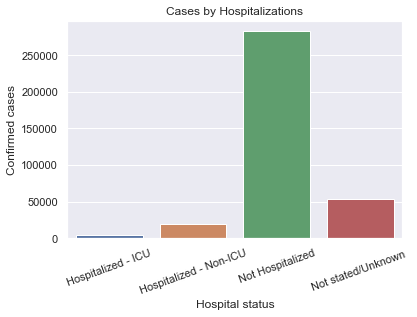

In [17]:
# 1.How the Hospitalization status rates differ?
# df['Hospital status'].value_counts().plot(kind='bar', title='Plotting cases by hospitalization', figsize=(10, 4),align='center');

df['Hospital status'].value_counts()
hospitalcounts=df['Hospital status'].value_counts().to_list()
criterias = ['Hospitalized - ICU', 'Hospitalized - Non-ICU', 'Not Hospitalized', 'Not stated/Unknown ']
ax=sns.countplot(df['Hospital status'])
ax.set_title('Cases by Hospitalizations')
ax.set_ylabel('Confirmed cases')
ax.set_xticklabels(criterias,rotation=20)



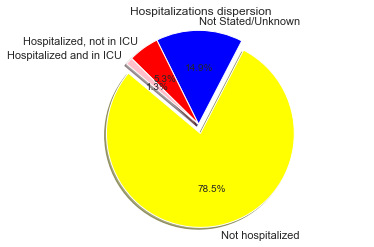

<Figure size 432x288 with 0 Axes>

In [18]:
hospitalcounts=df['Hospital status'].value_counts().to_list()
hospitalcounts

labels = 'Not hospitalized', 'Not Stated/Unknown', 'Hospitalized, not in ICU','Hospitalized and in ICU'
sizes = hospitalcounts
colors = ['yellow', 'blue', 'red','pink']
explode = (0.1,0,0,0)  # explode 1st slice

# Plot
plt.pie(sizes, explode=explode, labels=labels, colors=colors,
autopct='%1.1f%%', shadow=True, startangle=140)
plt.title("Hospitalizations dispersion")
plt.axis('equal')
plt.show()
plt.savefig('hospitalcountspiechart.jpg', format='jpg', dpi=1600)

In [22]:
#2. 2.How hospitalizations differ with age group?
hosp_age = df.groupby(['Age group', 'Hospital status']).size().unstack()
hosp_age.index=['0-19','20-29','30-39','40-49','50-59','60-69','70-79','80+','Not stated']
hosp_age.columns=['Hospitalized - ICU', 'Hospitalized - Non-ICU', 'Not Hospitalized', 'Not stated/Unknown ']
hosp_age

,Hospitalized - ICU,Hospitalized - Non-ICU,Not Hospitalized,Not stated/Unknown
0-19,21,291,44819,7689
20-29,114,588,54219,12430
30-39,182,961,46228,8509
40-49,351,1265,43210,7670
50-59,813,2156,37849,7659
60-69,1185,2706,22307,4596
70-79,1129,3829,12120,2159
80+,622,7288,21750,2544
Not stated,103,53,280,541


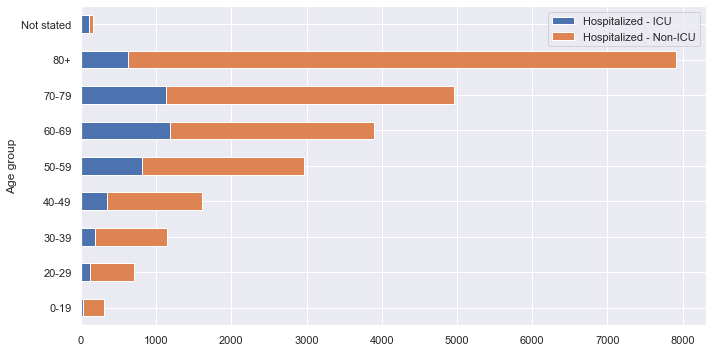

<Figure size 432x288 with 0 Axes>

In [559]:
hosp_age[[1, 2]].plot.barh(stacked = True, figsize = (10,5))
plt.legend(["Hospitalized - ICU", "Hospitalized - Non-ICU"])
plt.yticks(np.arange(9), ('0-19', '20-29', '30-39', '40-49', '50-59','60-69','70-79','80+','Not stated'))
plt.tight_layout()
plt.show()
plt.savefig('hospitalization by age.jpg')

In [31]:
# 3.How hospitalizations differ with gender?
gender_hosp = df.groupby(['Hospital status', 'Gender']).size().unstack(1)
gender_hosp.loc['Total hospitalized'] = gender_hosp.iloc[:2].sum()
gender_hosp

gender_hosp.index=['Hospitalized-ICU', 'Hospitalized-Non ICU', 'Not Hospitalized', 'Not stated/Unknown','Total hospitalized']
gender_hosp.columns=['Male', 'Female', 'Not stated/Unknown']
gender_hosp

,Male,Female,Not stated/Unknown
Hospitalized-ICU,2853,1659,8
Hospitalized-Non ICU,9525,9585,27
Not Hospitalized,132784,149346,652
Not stated/Unknown,26471,26242,1084
Total hospitalized,12378,11244,35


In [34]:
# 4.How death rates differ with hospitalization?
hospmort = df.groupby(['Hospital status', 'Death']).size().unstack().iloc[:2, :]
hospmort.loc['Total hospitalized'] = hospmort.iloc[:2].sum()
hospmort.index=['Hospitalized-ICU', 'Hospitalized-Non ICU','Total hospitalized']
hospmort.columns=['Dead-Yes', 'Dead-No', 'Dead-Not stated']
hospmort

,Dead-Yes,Dead-No,Dead-Not stated
Hospitalized-ICU,1218,2466,836
Hospitalized-Non ICU,3672,11890,3575
Total hospitalized,4890,14356,4411


# Deaths

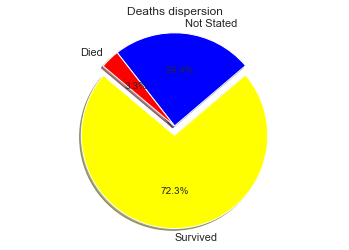

<Figure size 432x288 with 0 Axes>

In [562]:
# 1.What is the overall death rate?
df['Death'].value_counts()
deathcounts=df['Death'].value_counts().to_list()
deathcounts
labels = 'Survived', 'Not Stated', 'Died'
sizes = deathcounts
colors = ['yellow', 'blue', 'red']
explode = (0.1, 0,0)  # explode 1st slice

# Plot
plt.pie(sizes, explode=explode, labels=labels, colors=colors,
autopct='%1.1f%%', shadow=True, startangle=140)
plt.title("Deaths dispersion")
plt.axis('equal')
plt.show()
plt.savefig('deathpiechart.jpg', format='jpg', dpi=1600)

In [36]:
#2. isolate deaths and see details
deaths = df[df.Death == 1]
deaths_df=deaths[['Episode week','Onset week of symptoms','Recovery week']]
deaths_df.describe()

,Episode week,Onset week of symptoms,Recovery week
count,11951.000000,11951.000000,11951.0
mean,28.902770,57.868045,99.0
std,23.988221,38.621291,0.0
min,9.000000,9.000000,99.0
25%,15.000000,16.000000,99.0
50%,17.000000,45.000000,99.0
75%,41.000000,99.000000,99.0
max,99.000000,99.000000,99.0


In [44]:
# 3. How deaths very with gender?
sr=deaths.Gender.value_counts()
index_=['Female','Male','Not stated/Other']
sr.index = index_
print(sr)

Female              6247
Male                5656
Not stated/Other      48
Name: Gender, dtype: int64


In [45]:
# 4.How the cumulative deaths by gender vary with the time?
#cumulative deaths by gender

deaths_week = deaths.groupby(['Episode week', 'Gender']).size().reset_index(name = 'deaths')
deaths_week['Episode week'] = deaths_week['Episode week'].astype(int)
deaths_week.sort_values('Episode week', inplace = True)
deaths_week['Cumul deaths'] = deaths_week.groupby('Gender').deaths.cumsum()

fig=px.line(deaths_week, x = 'Episode week', y = 'Cumul deaths', color = 'Gender',labels={"Female", "Male","Not stated/Other"})

fig.show()

In [566]:
# 5.How the cumulative deaths by age group vary with the time? (What age groups has high risk to die?)


deaths_week = deaths.groupby(['Episode week', 'Age group']).size().reset_index(name = 'deaths')
deaths_week['Episode week'] = deaths_week['Episode week'].astype(int)
deaths_week.sort_values('Episode week', inplace = True)
deaths_week['Cumul deaths'] = deaths_week.groupby('Age group').deaths.cumsum()

px.line(deaths_week, x = 'Episode week', y = 'Cumul deaths', color = 'Age group')

Text(0.5, 1.0, 'How death rate differ over time')

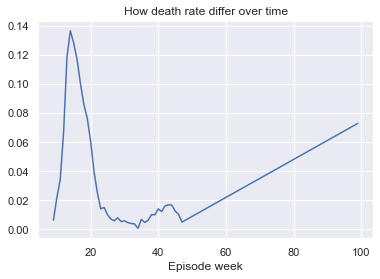

In [567]:
# 6.How death rate over time differs? (No of deaths divided by total cases by week)
a=df.groupby(['Episode week', 'Death']).size().unstack().apply(lambda x: x/ x.sum(), axis = 1)
a[1].plot()
plt.title("How death rate differ over time")

# Recovery

Text(0.5, 1.0, 'Recovery Cases')

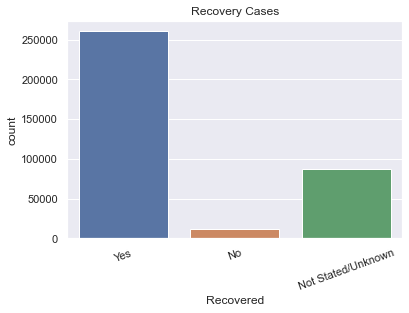

In [568]:
# 1.How the overall recovery rate behave?
df['Recovered'].value_counts()
criterias = ['Yes', 'No', 'Not Stated/Unknown']
ax=sns.countplot(df['Recovered'])
ax.set_xticklabels(criterias,rotation=20)
ax.set_title('Recovery Cases')

In [46]:
# 2.What is the std, mean, quartiles of episode week, onset week of symptoms, recovery week of recovered persons? (Details of recovered records)

#isolate Recovered and see details
Recovered = df[df.Recovered == 1]
Recovered_df=deaths[['Episode week','Onset week of symptoms','Recovery week']]
Recovered_df.describe()



,Episode week,Onset week of symptoms,Recovery week
count,11951.000000,11951.000000,11951.0
mean,28.902770,57.868045,99.0
std,23.988221,38.621291,0.0
min,9.000000,9.000000,99.0
25%,15.000000,16.000000,99.0
50%,17.000000,45.000000,99.0
75%,41.000000,99.000000,99.0
max,99.000000,99.000000,99.0


In [570]:
# 3.How the recovery rates differs with age groups?
df1=df.groupby(['Age group', 'Recovered']).size().unstack(0)
df1.columns=['0-19','20-29','30-39','40-49','50-59','60-69','70-79','80+','Not stated']
df1.index=['Yes','No','Not Stated/Unknown']
df1

,0-19,20-29,30-39,40-49,50-59,60-69,70-79,80+,Not stated
Yes,38722.0,49712.0,41902.0,40082.0,36594.0,22465.0,12974.0,17951.0,156.0
No,NaN,NaN,NaN,NaN,260.0,864.0,2221.0,8428.0,178.0
Not Stated/Unknown,14098.0,17639.0,13978.0,12414.0,11623.0,7465.0,4042.0,5825.0,643.0


In [451]:
# 4.How the cumulative recovery rate by gender vary with the time?

Recovered_week = Recovered.groupby(['Episode week', 'Gender']).size().reset_index(name = 'Recovered')
Recovered_week['Episode week'] = Recovered_week['Episode week'].astype(int)
Recovered_week.sort_values('Episode week', inplace = True)
Recovered_week['Cumul Recovered'] = Recovered_week.groupby('Recovered').Recovered.cumsum()

px.line(Recovered_week, x = 'Episode week', y = 'Cumul Recovered', color = 'Gender')

Text(0.5, 1.0, 'How recovery rate differ over time')

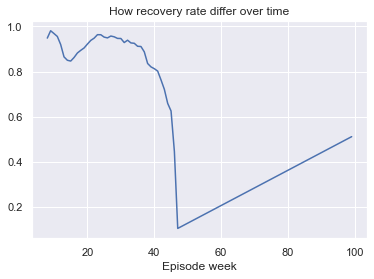

In [452]:
# 5.How recovery rate over time differs? (No of recovery divided by total cases by week)

#(No of recovery/total cases by week)
b=df.groupby(['Episode week', 'Recovered']).size().unstack().apply(lambda x: x/ x.sum(), axis = 1)
b[1].plot()
plt.title("How recovery rate differ over time")


In [453]:
# 6.Isolate recovered cases
recov = df[df['Recovery week'].notna()]
recov[['Episode week', 'Recovery week']] = recov[['Episode week', 'Recovery week']].astype(float)

# Calculate the lag between onset and recovery
recov['week_lag'] = recov['Recovery week'] - recov['Episode week']

recov_lags = recov.groupby('Age group').week_lag.describe()
recov_lags.index=['0-19','20-29','30-39','40-49','50-59','60-69','70-79','80+','Not stated']
recov_lags

,count,mean,std,min,25%,50%,75%,max
0-19,52820.0,28.869443,29.102724,-87.0,2.0,3.0,55.0,91.0
20-29,67351.0,35.486823,30.516567,-87.0,2.0,53.0,58.0,91.0
30-39,55880.0,33.947888,31.170841,-87.0,2.0,52.0,57.0,91.0
40-49,52496.0,32.260744,31.624395,-87.0,2.0,52.0,57.0,91.0
50-59,48477.0,34.788394,32.229287,-87.0,2.0,52.0,58.0,91.0
60-69,30794.0,36.090732,33.017563,-87.0,2.0,52.0,59.0,91.0
70-79,19237.0,37.104226,34.725687,-87.0,2.0,52.0,61.0,91.0
80+,32204.0,44.215874,34.888619,-86.0,4.0,54.0,81.0,91.0
Not stated,977.0,14.060389,29.842782,-80.0,0.0,0.0,2.0,90.0


Text(0.5, 1.0, 'Average and max recovery time (weeks) by age group')

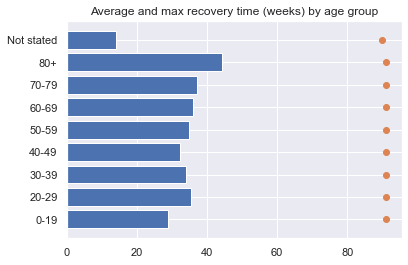

In [454]:
# 7.What is the Average time to recovery by age group?
fig, ax = plt.subplots()
ax.barh(recov_lags.index, recov_lags['mean'])
ax.scatter(recov_lags['max'], recov_lags.index)
plt.title('Average and max recovery time (weeks) by age group')
plt.xticks

In [455]:
#8.	How average recovery time vary with hospital status?
df2=recov.groupby('Hospital status').week_lag.mean()
df2.index=['Hospitalized - ICU','Hospitalized - Non-ICU','Not Hospitalized','Not stated/Unknown']
df2

Hospitalized - ICU        39.776991
Hospitalized - Non-ICU    41.462507
Not Hospitalized          29.817662
Not stated/Unknown        56.687566
Name: week_lag, dtype: float64

# Symptoms

In [48]:
#create a seperate dataframe with symptoms
# Isolate symptom columns

# Here I used the data preprocessing technique of Aggregation (Combining two or more attributes to a single attribute)
sympt = [c for c in df.columns if 'Symptom' in c]

# Create a dataframe of symptom counts
sympdf = df[sympt].apply(pd.Series.value_counts).T
sympdf.columns=['Yes','No','Not Stated/Unknown']
sympdf

,Yes,No,Not Stated/Unknown
"Symptom, cough",27578,2051,330607
"Symptom, fever",15791,3809,340636
"Symptom, chills",14725,3304,342207
"Symptom, sore throat",16255,4031,339950
"Symptom, runny nose",12606,3818,343812
"Symptom, shortness of breath",6860,4570,348806
"Symptom, nausea",4677,4980,350579
"Symptom, headache",21950,3036,335250
"Symptom, weakness",6504,3175,350557
"Symptom, pain",17771,3485,338980


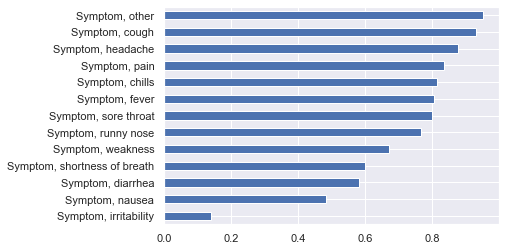

In [49]:
# 1.What is the most common symptom?
# Most common symptoms overall
sympdf[['Yes', 'No']].div(sympdf.Yes + sympdf.No, axis = 0).sort_values('Yes').Yes.plot.barh()

In [50]:
# 2.How many cases have symptom information?
(sympdf.No + sympdf.Yes).median()

18029.0

In [51]:
# 3.How the frequency of symptoms differ with age?
symptoms_age = (df.melt(id_vars = 'Age group', value_vars=sympt, var_name='Symptom').groupby(['Age group', 'Symptom', 'value']).size().unstack()
 .reset_index()
 .assign(prop = lambda x: x[1] / (x[2] + x[1]) * 100)
 .pivot(index = 'Symptom', columns = 'Age group', values = 'prop')
 )

symptoms_age.columns=['0-19','20-29','30-39','40-49','50-59','60-69','70-79','80+','Not stated']
symptoms_age

,0-19,20-29,30-39,40-49,50-59,60-69,70-79,80+,Not stated
Symptom,,,,,,,,,
"Symptom, chills",77.436823,85.196375,87.277427,86.531987,82.845332,79.405520,66.666667,39.501779,50.000000
"Symptom, cough",91.561562,93.850319,94.465013,94.717203,93.668612,92.501681,89.513109,87.367725,78.260870
"Symptom, diarrhea",51.713396,59.677419,61.974026,63.211058,60.074231,57.410180,52.897657,45.820433,43.548387
"Symptom, fever",85.254299,79.442086,82.915452,83.317565,80.020776,76.486200,73.166202,74.209012,53.947368
"Symptom, headache",89.364420,92.890085,91.855295,91.572905,88.037486,81.571562,62.974684,37.478109,57.142857
"Symptom, irritability",13.357401,12.021277,12.512219,14.509804,11.061151,13.255814,16.998192,27.642276,7.843137
"Symptom, nausea",51.177730,53.980583,51.127820,50.325098,48.763906,44.483363,41.097923,33.691756,25.000000
"Symptom, other",96.994196,96.756364,96.626181,95.441696,93.327556,91.445326,89.764869,93.290960,79.661017
"Symptom, pain",76.540418,86.511262,89.055065,89.681373,85.325132,79.331450,65.972945,43.657331,40.000000


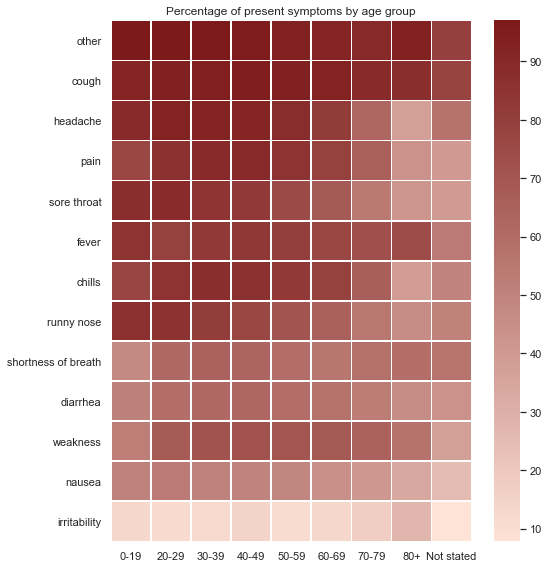

In [52]:
# 4.How the frequency of symptoms differ with age?

#plot frequency of symptoms by age

from matplotlib.colors import LinearSegmentedColormap     
cmap = LinearSegmentedColormap.from_list(name='CBC red', colors =['#fee3d7', '#7c1919'])

# Order index by most common symptom overall
sym_order = sympdf.sort_values('Yes', ascending = False).index
symptoms_age = symptoms_age.reindex(sym_order)

# Remvoe the word "Symptom" from the index
symptoms_age.index = symptoms_age.index.str.replace('Symptom, ', '')

# Plot
plt.figure(figsize=(8,8))
sns.heatmap(symptoms_age, linewidths=.5, cmap=cmap)
plt.title('Percentage of present symptoms by age group')
plt.tight_layout()

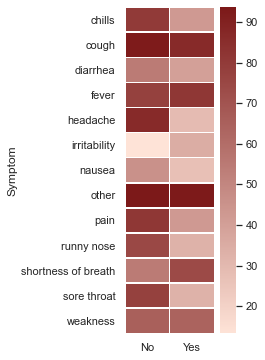

In [54]:
# 4.How the frequency of symptoms differ with Death?


symptoms_death =  (df.melt(id_vars = 'Death', value_vars=sympt, var_name='Symptom')
 .groupby(['Death', 'Symptom', 'value']).size()
 .unstack()
 .reset_index()
 .assign(prop = lambda x: x[1] / (x[2] + x[1]) * 100)
 .pivot(index = 'Symptom', columns = 'Death', values = 'prop')
 )
symptoms_death.columns=['Yes','No','Not Stated']
symptoms_death

symptoms_death.index = symptoms_death.index.str.replace('Symptom, ', '')

plt.figure(figsize=(2,6))
sns.heatmap(symptoms_death[['No', 'Yes']], linewidths=.5, cmap=cmap) 

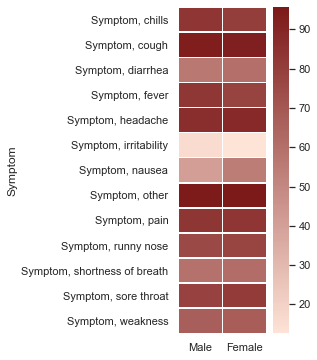

In [577]:
# 5.How the frequency of symptoms differ with Gender?

symptoms_gender =  (df.melt(id_vars = 'Gender', value_vars=sympt, var_name='Symptom')
 .groupby(['Gender', 'Symptom', 'value']).size()
 .unstack()
 .reset_index()
 .assign(prop = lambda x: x[1] / (x[2] + x[1]) * 100)
 .pivot(index = 'Symptom', columns = 'Gender', values = 'prop')
 )
symptoms_gender.columns=['Male','Female','Not Stated/Other']
symptoms_gender

plt.figure(figsize=(2,6))
sns.heatmap(symptoms_gender[['Male', 'Female']], linewidths=.5, cmap=cmap) 

In [597]:
# Dimensionality Reduction for the 13 symptoms columns
# Perform PCA for the symptoms

features = ['Symptom, cough', 'Symptom, fever', 'Symptom, chills', 'Symptom, sore throat','Symptom, runny nose','Symptom, shortness of breath','Symptom, nausea','Symptom, headache','Symptom, weakness','Symptom, pain','Symptom, irritability','Symptom, diarrhea','Symptom, other']

# Separating out the features
x = df.loc[:, features].values

# Separating out the target
y = df.loc[:,['Asymptomatic']].values

# Standardizing the features
x = StandardScaler().fit_transform(x)

pca = PCA(n_components=2)
principalComponents = pca.fit_transform(x)
principalDf = pd.DataFrame(data = principalComponents, columns = ['principal component 1', 'principal component 2'])

In [598]:
finalDf = pd.concat([principalDf, df[['Asymptomatic']]], axis = 1)
finalDf

,principal component 1,principal component 2,Asymptomatic
0,-0.794667,0.232705,9
1,0.403826,-0.218926,2
2,-0.794667,0.232705,1
3,-0.794667,0.232705,9
4,-0.794667,0.232705,9
...,...,...,...
360231,2.286133,-3.153791,2
360232,-0.794667,0.232705,9
360233,8.923608,0.409511,2
360234,-0.794667,0.232705,9


In [599]:
print (x.shape)
print (principalComponents.shape)

(360236, 13)
(360236, 2)


In [600]:
print(pca.components_)

[[-0.27605878 -0.26560164 -0.28029135 -0.27151945 -0.26337805 -0.28691331
  -0.28989772 -0.27886342 -0.28859079 -0.28474063 -0.29715002 -0.29025097
  -0.22486195]
 [ 0.30690368  0.1000411   0.09424085  0.15679587 -0.02547761 -0.21199584
  -0.30394887  0.26951631 -0.29262386  0.19479128 -0.42154106 -0.23375169
   0.54388532]]


In [601]:
print(pca.explained_variance_)

[7.10153313 1.27001248]


In [625]:
fig = px.scatter(principalComponents, x=0, y=1, color=df['Asymptomatic'],title="Dispersion of the Symptoms with the two Principle Components", 
                 
                 labels={
                    1:"Yes",
                    2:"No",
                    9:"Not Stated" 
                 }
                )
fig.show()

# transmission

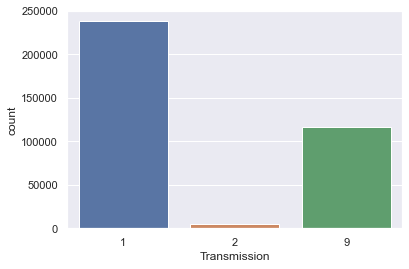

In [463]:
# 1.What is the common mode of transmission?

df['Transmission'].value_counts()
sns.countplot(df['Transmission'])

Text(0.5, 1.0, 'Count')

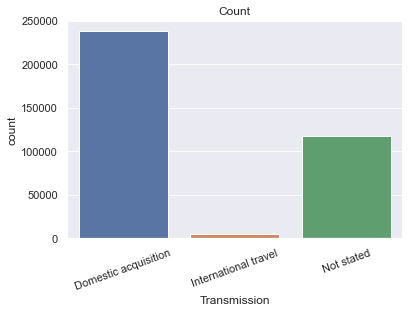

In [464]:
criterias = ['Domestic acquisition', 'International travel', 'Not stated']
ax=sns.countplot(df['Transmission'])
ax.set_xticklabels(criterias,rotation=20)
ax.set_title('Count')

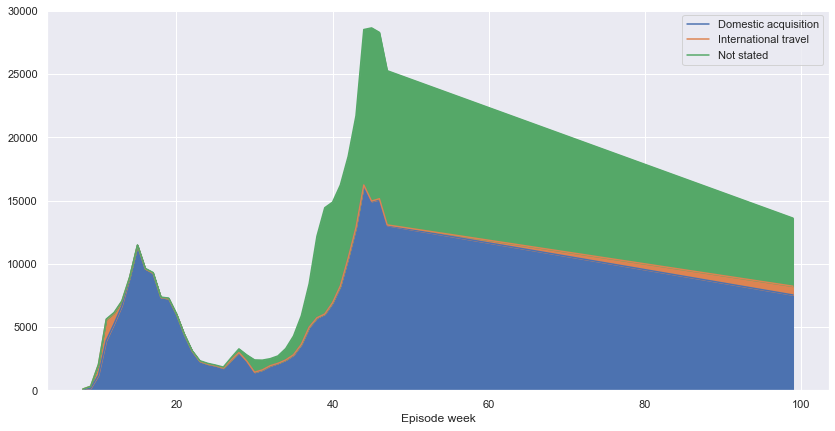

In [465]:
# 2.How the transmission type varies with the time?

#Transmission type over time
transmision_time = df.groupby(['Episode week', 'Transmission']).size().unstack()
transmision_time.index = transmision_time.index.astype(int)
transmision_time.sort_index().plot.area(figsize = (14,7))
plt.legend(["Domestic acquisition", "International travel","Not stated"])

# Operations

In [466]:
# Here I used the data preprocessing technique of feature creation. (Create new attributes that can capture the important information in a data
# set much more efficiently than the original attributes)

df_recded=df[['Episode week','Recovered','Death','Recovery week']]
df_recded=df_recded.sort_values(by=['Episode week'])
df_recded.loc[df_recded['Recovered'] ==1, 'ifrecovered'] = 1
df_recded.loc[df_recded['Death'] !=1, 'ifDeath'] = 0
df_recded.loc[df_recded['Recovered'] ==1, 'ifrecovered'] = 1
df_recded.loc[df_recded['Death'] !=1, 'ifDeath'] = 1
df_recded.loc[df_recded['Episode week'] != 0, 'ifcum'] = 1

df_recded['cum_rec']=df_recded['ifrecovered'].cumsum()
df_recded['cum_death']=df_recded['ifDeath'].cumsum()
df_recded['cum_all']=df_recded['ifcum'].cumsum()
df_recded

,Episode week,Recovered,Death,Recovery week,ifrecovered,ifDeath,ifcum,cum_rec,cum_death,cum_all
180070,8,1,2,15,1.0,1.0,1.0,1.0,1.0,1.0
79879,8,1,2,99,1.0,1.0,1.0,2.0,2.0,2.0
155909,8,1,2,99,1.0,1.0,1.0,3.0,3.0,3.0
95316,8,1,2,99,1.0,1.0,1.0,4.0,4.0,4.0
315069,8,1,2,16,1.0,1.0,1.0,5.0,5.0,5.0
...,...,...,...,...,...,...,...,...,...,...
119236,99,1,2,99,1.0,1.0,1.0,260555.0,348281.0,360232.0
195905,99,9,9,99,NaN,1.0,1.0,NaN,348282.0,360233.0
71149,99,1,2,99,1.0,1.0,1.0,260556.0,348283.0,360234.0
18091,99,1,2,23,1.0,1.0,1.0,260557.0,348284.0,360235.0


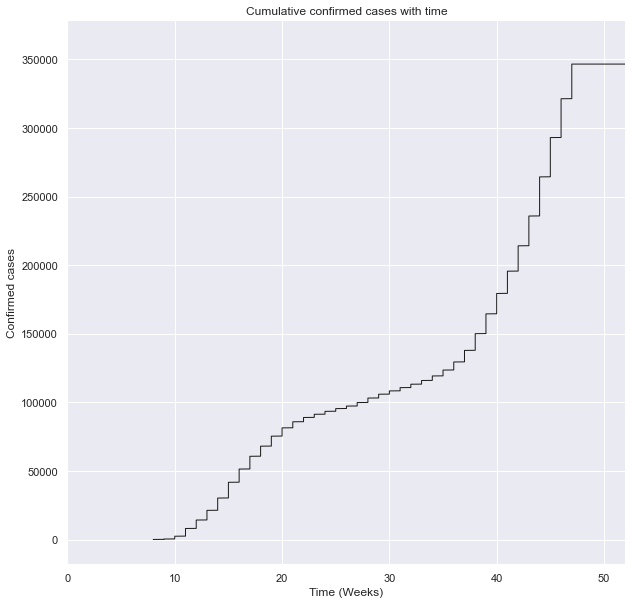

In [467]:
# 1. Confirmed cases variation with time
confirmed=df_recded.iloc[:,9]
Weeks = df_recded.iloc[:,0]
plt.figure(1, figsize=(10, 10))
plt.plot(Weeks,confirmed , 'k', lw=1)
plt.xlim([0,52])
sns.despine()
plt.xlabel('Time (Weeks)')
plt.ylabel('Confirmed cases');
plt.title("Cumulative confirmed cases with time")
plt.show()

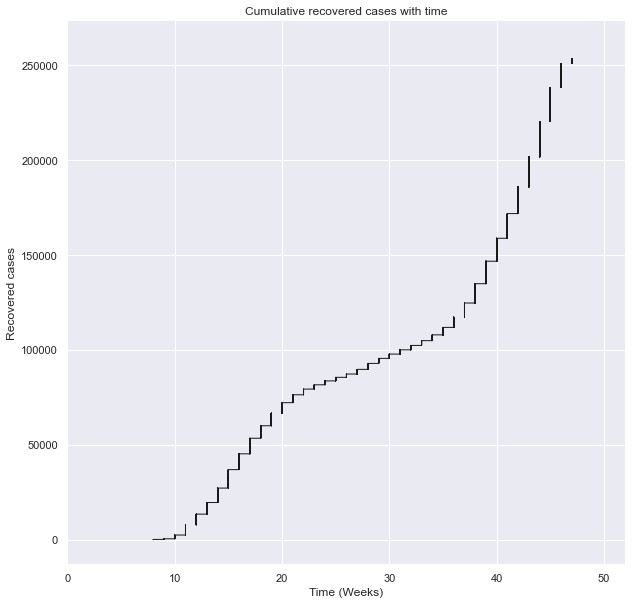

In [468]:
# 2. recovered cases variation with time
recovered=df_recded.iloc[:,7]
Weeks = df_recded.iloc[:,0]
plt.figure(1, figsize=(10, 10))
plt.plot(Weeks,recovered , 'k', lw=1)
plt.xlim([0,52])
sns.despine()
plt.xlabel('Time (Weeks)')
plt.ylabel('Recovered cases');
plt.title("Cumulative recovered cases with time")
plt.show()

In [469]:
df_recded.iloc[:,7]

180070         1.0
79879          2.0
155909         3.0
95316          4.0
315069         5.0
            ...   
119236    260555.0
195905         NaN
71149     260556.0
18091     260557.0
289995    260558.0
Name: cum_rec, Length: 360236, dtype: float64

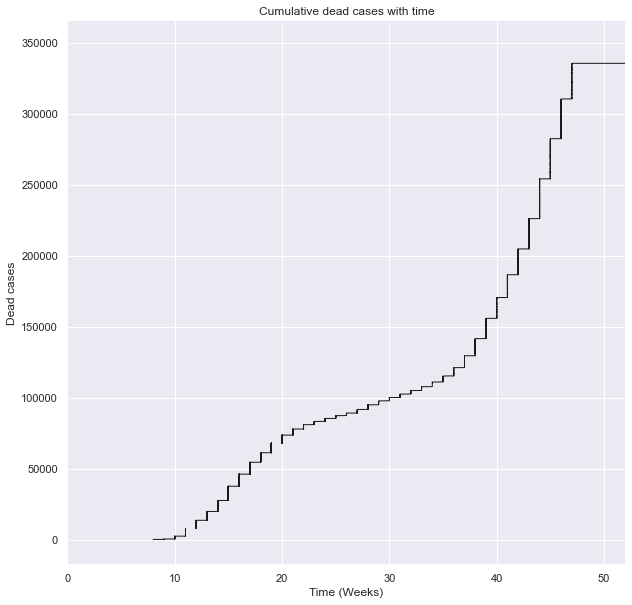

In [413]:
# 3. Dead cases variation with time
dead=df_recded.iloc[:,8]
Weeks = df_recded.iloc[:,0]
plt.figure(1, figsize=(10, 10))
plt.plot(Weeks,dead , 'k', lw=1)
plt.xlim([0,52])
sns.despine()
plt.xlabel('Time (Weeks)')
plt.ylabel('Dead cases');
plt.title("Cumulative dead cases with time")
plt.show()